In [24]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import wandb
import os
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import DataLoader, TensorDataset

# Set random seeds for reproducibility
np.random.seed(42)
torch.manual_seed(42)

# Task 3 - Deep versus wide networks

## Data Generation for Noisy-XOR Problem

We'll generate data points according to the formula:
$(x_1, x_2, y) = (m_1 + s\eta_1, m_2 + s\eta_2, m_1 \text{ xor } m_2)$

where $(m_1, m_2) \in \{(0,0), (0,1), (1,0), (1,1)\}$ are cluster centers, $s$ is the standard deviation, and $\eta_1, \eta_2$ are normally distributed random variables.

In [25]:
class NoisyXORGenerator:
    def __init__(self, s=0.1, seed=None):
        # s: standard deviation for noise
        # seed: random seed for reproducibility
        self.s = s
        self.seed = seed
        
        # Four cluster centers for XOR problem
        self.cluster_centers = np.array([
            [0, 0],  # XOR output: 0
            [0, 1],  # XOR output: 1
            [1, 0],  # XOR output: 1
            [1, 1]   # XOR output: 0
        ])
        
        # XOR labels for each cluster
        self.cluster_labels = np.array([0, 1, 1, 0])
    
    def generate(self, n_samples):
        # Generate noisy XOR data with n_samples points
        if self.seed is not None:
            np.random.seed(self.seed)
        
        # Distribute samples evenly across clusters
        samples_per_cluster = n_samples // 4
        remainder = n_samples % 4
        
        X = []
        y = []
        
        for i in range(4):
            n = samples_per_cluster + (1 if i < remainder else 0)
            
            # Add Normal(0,1) noise scaled by s
            eta = np.random.randn(n, 2)
            cluster_samples = self.cluster_centers[i] + self.s * eta
            
            X.append(cluster_samples)
            y.append(np.full(n, self.cluster_labels[i]))
        
        X = np.vstack(X)
        y = np.concatenate(y)
        
        # Shuffle the data
        indices = np.random.permutation(n_samples)
        X = X[indices]
        y = y[indices]
        
        return X, y
    
    def generate_train_val(self, n_train=2000, n_val=500):
        # Generate separate training and validation sets
        X_train, y_train = self.generate(n_train)
        
        # Use different seed for validation data
        old_seed = self.seed
        if self.seed is not None:
            self.seed += 1
        
        X_val, y_val = self.generate(n_val)
        
        # Restore original seed
        self.seed = old_seed
        
        return X_train, X_val, y_train, y_val

# Create generator and generate sample dataset
generator = NoisyXORGenerator(s=0.1, seed=42)
X, y = generator.generate(1000)

print(f"Generated {len(X)} samples")
print(f"Feature shape: {X.shape}")
print(f"Label shape: {y.shape}")
print(f"Class distribution: {np.bincount(y.astype(int))}")

Generated 1000 samples
Feature shape: (1000, 2)
Label shape: (1000,)
Class distribution: [500 500]


### Visualization of the Generated Data

Let's visualize the noisy-XOR dataset with different noise levels to understand the problem better.

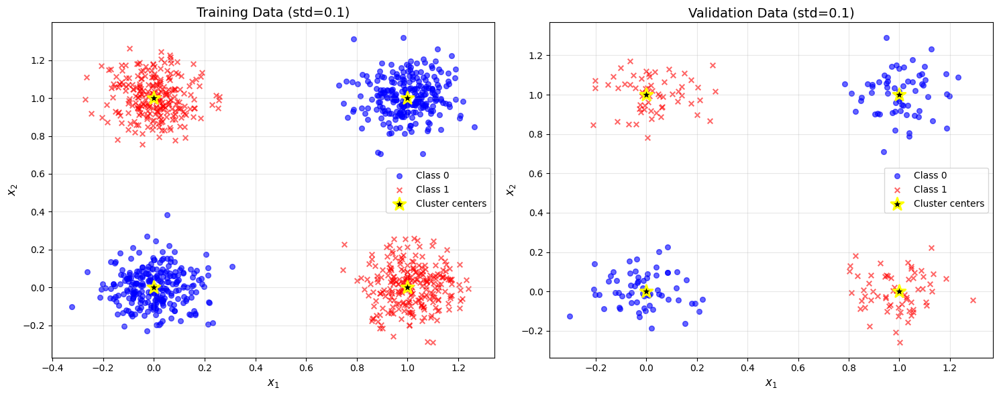

In [26]:
def visualize_train_validation(n_train=1000, n_val=250, s=0.1):
    # Generate data
    gen = NoisyXORGenerator(s=s, seed=42)
    X_train, X_val, y_train, y_val = gen.generate_train_val(n_train, n_val)
    
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    datasets = [(X_train, y_train, "Training Data"), (X_val, y_val, "Validation Data")]
    
    for i, (X, y, title) in enumerate(datasets):
        ax = axes[i]
        
        # Plot class 0 and 1
        mask_0 = y == 0
        mask_1 = y == 1
        ax.scatter(X[mask_0, 0], X[mask_0, 1], 
                c='blue', marker='o', s=30, alpha=0.6, label='Class 0')
        ax.scatter(X[mask_1, 0], X[mask_1, 1], 
                c='red', marker='x', s=30, alpha=0.6, label='Class 1')
        
        # Mark cluster centers
        centers = np.array([[0, 0], [0, 1], [1, 0], [1, 1]])
        ax.scatter(centers[:, 0], centers[:, 1], 
                c='black', marker='*', s=200, 
                edgecolors='yellow', linewidths=2, 
                label='Cluster centers', zorder=5)
        
        ax.set_xlabel('$x_1$', fontsize=12)
        ax.set_ylabel('$x_2$', fontsize=12)
        ax.set_title(f'{title} (std={s})', fontsize=14)
        ax.legend()
        ax.grid(True, alpha=0.3)
        
    plt.tight_layout()
    plt.show()

# Visualize training and validation data
visualize_train_validation(n_train=1000, n_val=250, s=0.1)

### Train/Validation Split

Let's create training and validation datasets for model evaluation.

In [27]:
# Create datasets using the generator
generator = NoisyXORGenerator(s=0.1, seed=42)
X_train, X_val, y_train, y_val = generator.generate_train_val(n_train=2000, n_val=500)

print("Training set:")
print(f"  X_train shape: {X_train.shape}")
print(f"  y_train shape: {y_train.shape}")
print(f"  Class distribution: {np.bincount(y_train.astype(int))}")
print()
print("Validation set:")
print(f"  X_val shape: {X_val.shape}")
print(f"  y_val shape: {y_val.shape}")
print(f"  Class distribution: {np.bincount(y_val.astype(int))}")

Training set:
  X_train shape: (2000, 2)
  y_train shape: (2000,)
  Class distribution: [1000 1000]

Validation set:
  X_val shape: (500, 2)
  y_val shape: (500,)
  Class distribution: [250 250]


### Decision Boundary Visualization Helper

This function will be useful later to visualize the decision boundaries learned by neural networks.

In [28]:
def plot_decision_boundary(model, X, y, title="Decision Boundary", resolution=0.01):
    # Plot decision boundary for a binary classifier
    # model: trained model with predict method
    # X: input features, y: true labels
    
    # Create mesh grid for decision boundary
    x_min, x_max = X[:, 0].min() - 0.3, X[:, 0].max() + 0.3
    y_min, y_max = X[:, 1].min() - 0.3, X[:, 1].max() + 0.3
    xx, yy = np.meshgrid(np.arange(x_min, x_max, resolution),
                         np.arange(y_min, y_max, resolution))
    
    # Predict on the mesh
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot decision boundary
    plt.figure(figsize=(8, 6))
    plt.contourf(xx, yy, Z, alpha=0.3, levels=1, cmap='RdBu')
    plt.contour(xx, yy, Z, levels=[0.5], colors='black', linewidths=2)
    
    # Plot data points
    mask_0 = y == 0
    mask_1 = y == 1
    plt.scatter(X[mask_0, 0], X[mask_0, 1], 
               c='blue', marker='o', s=30, alpha=0.6, label='Class 0', edgecolors='k')
    plt.scatter(X[mask_1, 0], X[mask_1, 1], 
               c='red', marker='x', s=30, alpha=0.6, label='Class 1')
    
    # Mark cluster centers
    centers = np.array([[0, 0], [0, 1], [1, 0], [1, 1]])
    plt.scatter(centers[:, 0], centers[:, 1], 
               c='black', marker='*', s=200, 
               edgecolors='yellow', linewidths=2, 
               label='Cluster centers', zorder=5)
    
    plt.xlabel('$x_1$', fontsize=12)
    plt.ylabel('$x_2$', fontsize=12)
    plt.title(title, fontsize=14)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

print("Decision boundary visualization function defined.")

Decision boundary visualization function defined.


In [29]:
class DynamicXORModel(nn.Module):
    def __init__(self, input_dim=2, hidden_layers=1, hidden_dim=10, output_dim=1):
        super(DynamicXORModel, self).__init__()
        layers = []
        current_dim = input_dim
        # Create hidden layers
        for _ in range(hidden_layers):
            layers.append(nn.Linear(in_features=current_dim, out_features=hidden_dim))
            layers.append(nn.Tanh())
            current_dim = hidden_dim
        # Output layer
        layers.append(nn.Linear(in_features=current_dim, out_features=output_dim))
        # Sigmoid removed to use BCEWithLogitsLoss
        self.network = nn.Sequential(*layers)
        
    def forward(self, x):
        return self.network(x)
    
    def predict(self, X):
        self.eval()
        with torch.no_grad():
            if isinstance(X, np.ndarray):
                X_tensor = torch.FloatTensor(X)
            else:
                X_tensor = X
            # Apply sigmoid to logits for prediction
            predictions = torch.sigmoid(self.forward(X_tensor))
            return predictions.numpy()

In [30]:
# Prepare data for PyTorch
# Convert numpy arrays to tensors
X_train_tensor = torch.FloatTensor(X_train)
y_train_tensor = torch.FloatTensor(y_train).unsqueeze(1) # Add dimension for BCELoss
X_val_tensor = torch.FloatTensor(X_val)
y_val_tensor = torch.FloatTensor(y_val).unsqueeze(1)

# Create TensorDatasets
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)

# Create DataLoaders
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

print(f"Data prepared: {len(train_dataset)} training samples, {len(val_dataset)} validation samples.")

Data prepared: 2000 training samples, 500 validation samples.


In [31]:
def train_loop(model, train_loader, val_loader, criterion, optimizer, epochs, verbose=True):
    train_losses = []
    val_losses = []
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * inputs.size(0)
        
        epoch_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_train_loss)
        
        # Validation phase
        model.eval()
        running_val_loss = 0.0
        with torch.no_grad():
            for inputs, targets in val_loader:
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                running_val_loss += loss.item() * inputs.size(0)
        
        epoch_val_loss = running_val_loss / len(val_loader.dataset)
        val_losses.append(epoch_val_loss)
        
        if verbose:
            print(f"Epoch {epoch+1}/{epochs} | Train Loss: {epoch_train_loss:.5f} | Val Loss: {epoch_val_loss:.5f}")
            
    return train_losses, val_losses

Epoch 1/35 | Train Loss: 0.68731 | Val Loss: 0.65719
Epoch 2/35 | Train Loss: 0.61584 | Val Loss: 0.54915
Epoch 3/35 | Train Loss: 0.45983 | Val Loss: 0.34640
Epoch 4/35 | Train Loss: 0.25347 | Val Loss: 0.16021
Epoch 2/35 | Train Loss: 0.61584 | Val Loss: 0.54915
Epoch 3/35 | Train Loss: 0.45983 | Val Loss: 0.34640
Epoch 4/35 | Train Loss: 0.25347 | Val Loss: 0.16021
Epoch 5/35 | Train Loss: 0.11460 | Val Loss: 0.07318
Epoch 5/35 | Train Loss: 0.11460 | Val Loss: 0.07318
Epoch 6/35 | Train Loss: 0.05656 | Val Loss: 0.04026
Epoch 7/35 | Train Loss: 0.03338 | Val Loss: 0.02556
Epoch 8/35 | Train Loss: 0.02238 | Val Loss: 0.01795
Epoch 6/35 | Train Loss: 0.05656 | Val Loss: 0.04026
Epoch 7/35 | Train Loss: 0.03338 | Val Loss: 0.02556
Epoch 8/35 | Train Loss: 0.02238 | Val Loss: 0.01795
Epoch 9/35 | Train Loss: 0.01623 | Val Loss: 0.01341
Epoch 9/35 | Train Loss: 0.01623 | Val Loss: 0.01341
Epoch 10/35 | Train Loss: 0.01239 | Val Loss: 0.01042
Epoch 11/35 | Train Loss: 0.00986 | Val Loss:

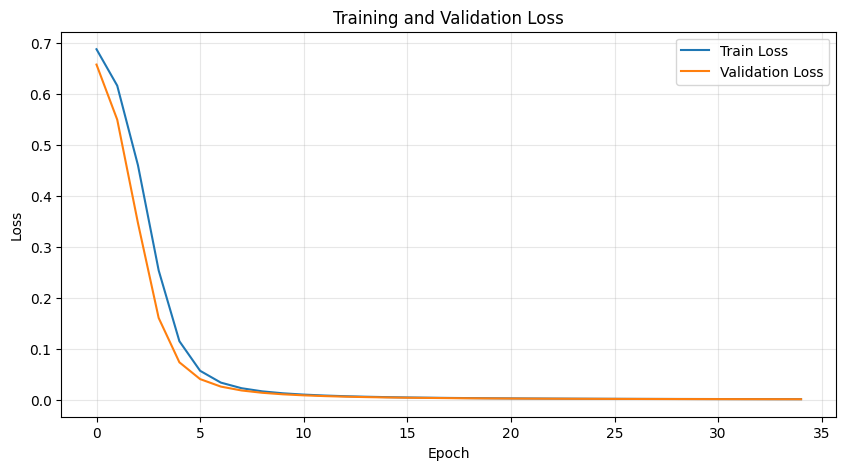

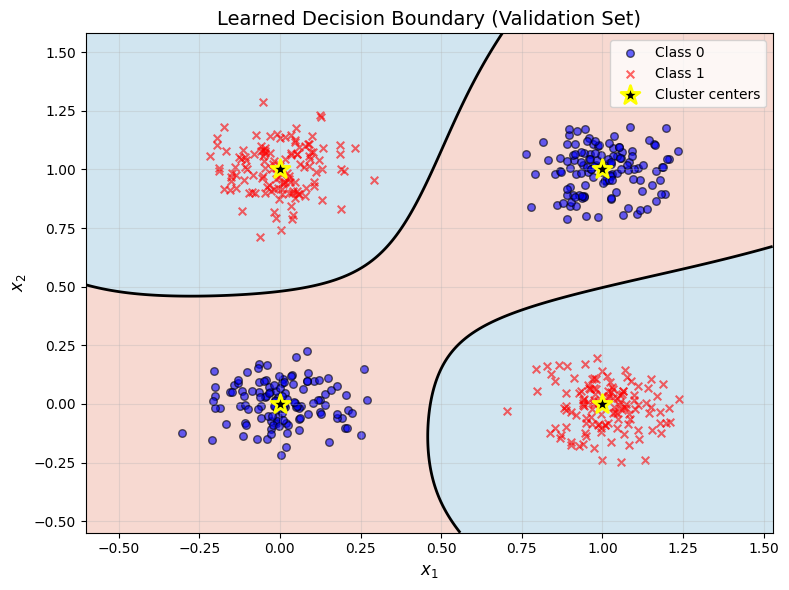

In [32]:
# Initialize model, criterion, and optimizer
# Using 1 hidden layer with 20 neurons as a baseline
model = DynamicXORModel(hidden_layers=1, hidden_dim=20)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Train the model
train_losses, val_losses = train_loop(model, train_loader, val_loader, criterion, optimizer, epochs=35)

# Visualization
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# Plot decision boundary
plot_decision_boundary(model, X_val, y_val, title="Learned Decision Boundary (Validation Set)")

We will now test a range of network architectures to see how depth and width affect performance on the noisy-XOR problem.

For each combination, we will train the model multiple times and report the mean and standard deviation of the validation loss.

In [33]:
# Experiment Configuration
depths = [0, 1, 2, 3, 5, 10, 20]
widths = [1, 2, 3, 5, 10, 20]
n_repetitions = 6  # Number of runs per configuration
epochs = 25

results_list = []

print(f"Starting experiment with depths={depths}, widths={widths}, repetitions={n_repetitions}")
print("-" * 60)
print(f"{'Depth':<10} {'Width':<10} {'Mean Val Loss':<15} {'Std Dev':<15}")
print("-" * 60)

for depth in depths:
    for width in widths:
        config_losses = []
        
        for i in range(n_repetitions):
            # Initialize model with specific architecture
            # Note: For depth=0, width parameter is ignored by our logic but we pass it anyway
            model = DynamicXORModel(input_dim=2, hidden_layers=depth, hidden_dim=width, output_dim=1)
            criterion = nn.BCEWithLogitsLoss()
            optimizer = optim.Adam(model.parameters(), lr=0.01)
            
            # Train (suppress output with verbose=False)
            _, val_losses = train_loop(model, train_loader, val_loader, criterion, optimizer, epochs=epochs, verbose=False)
            
            # Record final validation loss
            final_loss = val_losses[-1]
            config_losses.append(final_loss)
            
        mean_loss = np.mean(config_losses)
        std_loss = np.std(config_losses)
        
        results_list.append({
            'Depth': depth, 
            'Width': width, 
            'Mean Val Loss': mean_loss, 
            'Std Dev': std_loss
        })
        
        print(f"{depth:<10} {width:<10} {mean_loss:<15.5f} {std_loss:<15.3f}")

# Store results in a DataFrame
results_df = pd.DataFrame(results_list)

Starting experiment with depths=[0, 1, 2, 3, 5, 10, 20], widths=[1, 2, 3, 5, 10, 20], repetitions=6
------------------------------------------------------------
Depth      Width      Mean Val Loss   Std Dev        
------------------------------------------------------------
0          1          0.69319         0.000          
0          1          0.69319         0.000          
0          2          0.69321         0.000          
0          2          0.69321         0.000          
0          3          0.69326         0.000          
0          3          0.69326         0.000          
0          5          0.69320         0.000          
0          5          0.69320         0.000          
0          10         0.69324         0.000          
0          10         0.69324         0.000          
0          20         0.69320         0.000          
0          20         0.69320         0.000          
1          1          0.48911         0.002          
1          1          

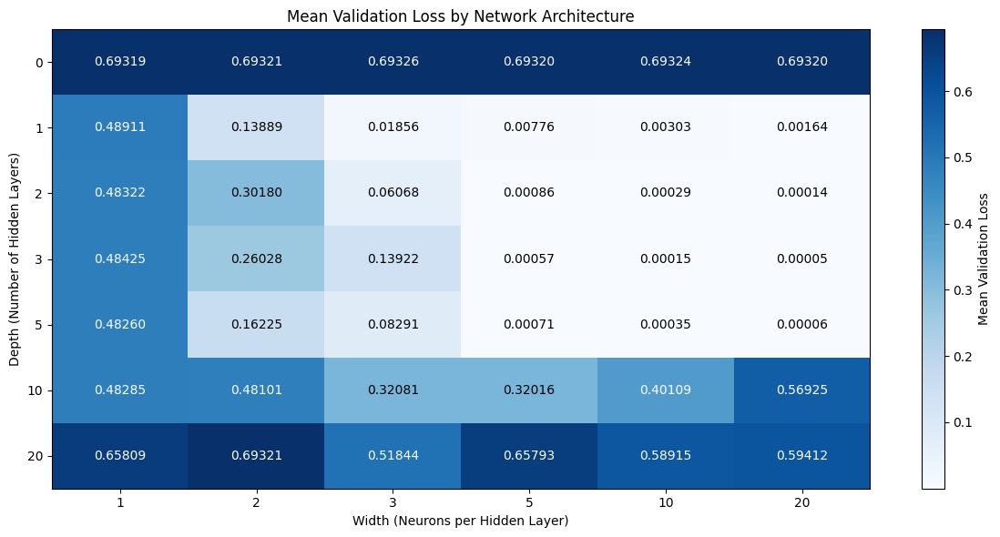

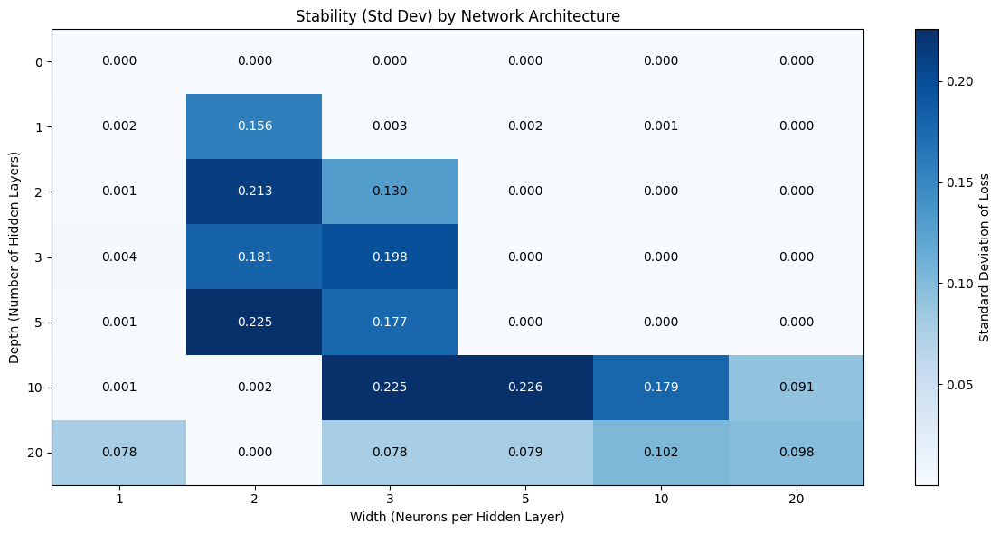

In [34]:
# Visualize the results
plt.figure(figsize=(12, 6))

# Pivot data for heatmap
# Use pivot_table instead of pivot to handle potential duplicate entries
pivot_table = results_df.pivot_table(index='Depth', columns='Width', values='Mean Val Loss')

# Plot heatmap
plt.imshow(pivot_table, cmap='Blues', aspect='auto')
plt.colorbar(label='Mean Validation Loss')
plt.xlabel('Width (Neurons per Hidden Layer)')
plt.ylabel('Depth (Number of Hidden Layers)')
plt.title('Mean Validation Loss by Network Architecture')

# Set ticks
plt.xticks(range(len(pivot_table.columns)), pivot_table.columns)
plt.yticks(range(len(pivot_table.index)), pivot_table.index)

# Add text annotations
for i in range(len(pivot_table.index)):
    for j in range(len(pivot_table.columns)):
        value = pivot_table.iloc[i, j]
        plt.text(j, i, f'{value:.5f}', ha='center', va='center', color='black' if value < 0.35 else 'white')

plt.tight_layout()
plt.show()

# Also plot standard deviation
plt.figure(figsize=(12, 6))
pivot_std = results_df.pivot_table(index='Depth', columns='Width', values='Std Dev')
plt.imshow(pivot_std, cmap='Blues', aspect='auto')
plt.colorbar(label='Standard Deviation of Loss')
plt.xlabel('Width (Neurons per Hidden Layer)')
plt.ylabel('Depth (Number of Hidden Layers)')
plt.title('Stability (Std Dev) by Network Architecture')
plt.xticks(range(len(pivot_std.columns)), pivot_std.columns)
plt.yticks(range(len(pivot_std.index)), pivot_std.index)

for i in range(len(pivot_std.index)):
    for j in range(len(pivot_std.columns)):
        value = pivot_std.iloc[i, j]
        plt.text(j, i, f'{value:.3f}', ha='center', va='center', color='black' if value < 0.15 else 'white')

plt.tight_layout()
plt.show()

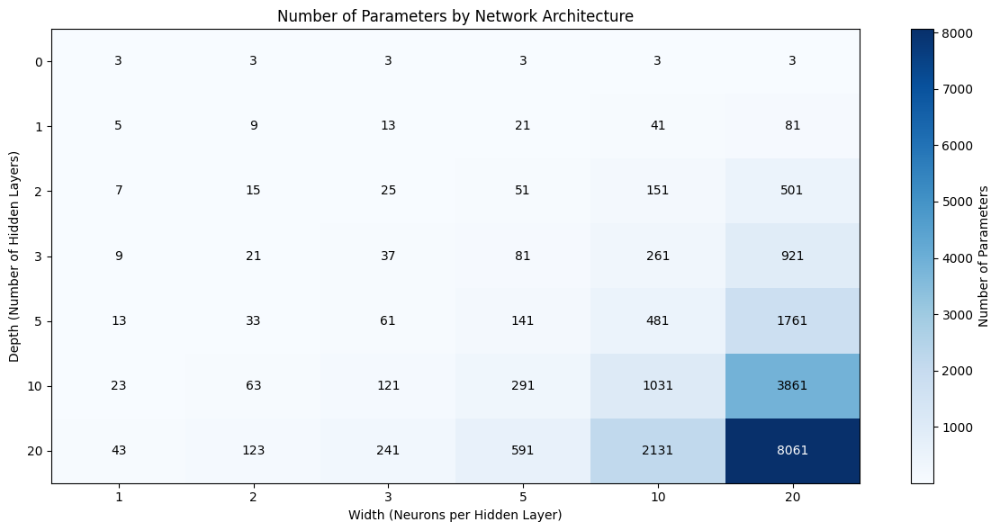

In [35]:
# Calculate number of parameters for each configuration
param_counts = []

for depth in depths:
    for width in widths:
        # Instantiate model to count parameters
        model = DynamicXORModel(input_dim=2, hidden_layers=depth, hidden_dim=width, output_dim=1)
        total_params = sum(p.numel() for p in model.parameters())
        
        param_counts.append({
            'Depth': depth,
            'Width': width,
            'Parameters': total_params
        })

params_df = pd.DataFrame(param_counts)

# Visualize Parameter Counts
plt.figure(figsize=(12, 6))
pivot_params = params_df.pivot_table(index='Depth', columns='Width', values='Parameters')
plt.imshow(pivot_params, cmap='Blues', aspect='auto')
plt.colorbar(label='Number of Parameters')
plt.xlabel('Width (Neurons per Hidden Layer)')
plt.ylabel('Depth (Number of Hidden Layers)')
plt.title('Number of Parameters by Network Architecture')
plt.xticks(range(len(pivot_params.columns)), pivot_params.columns)
plt.yticks(range(len(pivot_params.index)), pivot_params.index)

for i in range(len(pivot_params.index)):
    for j in range(len(pivot_params.columns)):
        value = pivot_params.iloc[i, j]
        plt.text(j, i, f'{int(value)}', ha='center', va='center', color='black' if value < pivot_params.max().max()/2 else 'white')

plt.tight_layout()
plt.show()

In [36]:
# 2 inputs -> 2 hidden units (Tanh) -> 1 output (Linear)
model_viz = DynamicXORModel(input_dim=2, hidden_layers=1, hidden_dim=2, output_dim=1)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model_viz.parameters(), lr=0.05) # Higher LR to see faster convergence in animation

# Store weights history
history = []
epochs = 1000

print("Training minimal network for animation...")

for epoch in range(epochs):
    # Training step
    model_viz.train()
    optimizer.zero_grad()
    outputs = model_viz(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    
    # Save weights and bias every few epochs
    if epoch % 20 == 0 or epoch == epochs - 1:
        # Extract weights (assuming structure: Linear -> Tanh -> Linear)
        # Layer 1
        W1 = model_viz.network[0].weight.detach().numpy().copy()
        b1 = model_viz.network[0].bias.detach().numpy().copy()
        # Layer 2
        W2 = model_viz.network[2].weight.detach().numpy().copy()
        b2 = model_viz.network[2].bias.detach().numpy().copy()
        
        history.append({
            'epoch': epoch,
            'loss': loss.item(),
            'W1': W1, 'b1': b1,
            'W2': W2, 'b2': b2
        })

print(f"Training complete. Captured {len(history)} frames.")

# 2. Create Animation
def create_training_animation(history, X, y):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    plt.close() # Prevent double display
    
    # Create meshgrid for visualization
    xx, yy = np.meshgrid(np.linspace(-0.5, 1.5, 100),
                         np.linspace(-0.5, 1.5, 100))
    X_grid = np.c_[xx.ravel(), yy.ravel()]
    
    def update(frame_idx):
        data = history[frame_idx]
        W1, b1 = data['W1'], data['b1']
        W2, b2 = data['W2'], data['b2']
        
        # Manual forward pass using numpy
        # Layer 1: Linear + Tanh
        z1 = X_grid @ W1.T + b1
        h = np.tanh(z1)
        
        # Layer 2: Linear + Sigmoid (Manually applied for visualization)
        z2 = h @ W2.T + b2
        out = 1 / (1 + np.exp(-z2))
        
        titles = ["Hidden Neuron 1", "Hidden Neuron 2", "Output"]
        activations = [h[:, 0], h[:, 1], out.flatten()]
        
        for i, ax in enumerate(axes):
            ax.clear()
            Z = activations[i].reshape(xx.shape)
            
            # Plot contour
            # For Tanh (Hidden), boundary is 0. For Sigmoid (Output), boundary is 0.5
            levels = [0] if i < 2 else [0.5]
            
            # Background color
            ax.contourf(xx, yy, Z, alpha=0.6, cmap='RdBu', vmin=-1 if i<2 else 0, vmax=1)
            
            # Decision boundary line
            try:
                ax.contour(xx, yy, Z, levels=levels, colors='black', linewidths=2)
            except:
                pass # No boundary in range
            
            # Plot data points
            mask_0 = y == 0
            mask_1 = y == 1
            ax.scatter(X[mask_0, 0], X[mask_0, 1], c='blue', marker='o', edgecolors='k', alpha=0.5)
            ax.scatter(X[mask_1, 0], X[mask_1, 1], c='red', marker='x', alpha=0.5)
            
            ax.set_title(titles[i])
            ax.set_xlim(-0.5, 1.5)
            ax.set_ylim(-0.5, 1.5)
            
        fig.suptitle(f"Epoch {data['epoch']} | Loss: {data['loss']:.4f}", fontsize=14)

    ani = animation.FuncAnimation(fig, update, frames=len(history), interval=100)
    return ani

# Generate and display animation (this might take some time to make).
ani = create_training_animation(history, X_train, y_train)
HTML(ani.to_jshtml())

Training minimal network for animation...
Training complete. Captured 51 frames.
Training complete. Captured 51 frames.


# Task 4 - MLOps

In [37]:
os.environ['WANDB_API_KEY'] = 'ee8848e4b81bff3ea50b004f3b28ce2deb74c1b1'
os.environ['WANDB_DIR'] = "/tmp"

In [38]:
# Training Loop with W&B Logging
def train_with_wandb(model, train_loader, val_loader, criterion, optimizer, epochs, config):
    # Initialize W&B
    wandb.init(
        project="noisy-xor-classification",
        config=config,
        name=f"depth{config['hidden_layers']}_width{config['hidden_dim']}"
    )
    
    # Watch the model
    wandb.watch(model, criterion, log="all", log_freq=10)
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item() * inputs.size(0)
            # Use 0.0 threshold for logits
            predicted = (outputs > 0.0).float()
            total += targets.size(0)
            correct += (predicted == targets).sum().item()
        
        epoch_train_loss = running_loss / len(train_loader.dataset)
        epoch_train_acc = 100 * correct / total
        
        # Validation phase
        model.eval()
        running_val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for inputs, targets in val_loader:
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                running_val_loss += loss.item() * inputs.size(0)
                
                # Use 0.0 threshold for logits
                predicted = (outputs > 0.0).float()
                total += targets.size(0)
                correct += (predicted == targets).sum().item()
        
        epoch_val_loss = running_val_loss / len(val_loader.dataset)
        epoch_val_acc = 100 * correct / total
        
        # Log metrics to W&B
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": epoch_train_loss,
            "train_accuracy": epoch_train_acc,
            "val_loss": epoch_val_loss,
            "val_accuracy": epoch_val_acc,
            "learning_rate": optimizer.param_groups[0]['lr']
        })
    
    wandb.finish()

In [39]:
# Configuration
config = {
    "architecture": "DynamicXORModel",
    "input_dim": 2,
    "hidden_layers": 3,
    "hidden_dim": 10,
    "output_dim": 1,
    "optimizer": "Adam",
    "learning_rate": 0.01,
    "batch_size": 64,
    "epochs": 50,
    "loss_function": "BCEWithLogitsLoss",
}

# Initialize model
model = DynamicXORModel(
    input_dim=config["input_dim"],
    hidden_layers=config["hidden_layers"],
    hidden_dim=config["hidden_dim"],
    output_dim=config["output_dim"]
)

criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=config["learning_rate"])

In [40]:
# Train the model with W&B logging
train_with_wandb(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    epochs=config["epochs"],
    config=config
)

wandb: Currently logged in as: victor-vangkilde (victor-vangkilde-university-of-copenhagen) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
learning_rate,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_accuracy,▁▇██████████████████████████████████████
train_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
learning_rate,0.01
train_accuracy,100
train_loss,6e-05
val_accuracy,100


In [41]:
# Hyperparameter sweep configuration
sweep_config = {
    'method': 'bayes',
    'metric': {
        'name': 'val_loss',
        'goal': 'minimize'
    },
    'parameters': {
        'hidden_layers': {
            'values': [1, 2, 3, 5]
        },
        'hidden_dim': {
            'values': [5, 10, 20, 30]
        },
        'learning_rate': {
            'distribution': 'log_uniform_values',
            'min': 0.001,
            'max': 0.1
        },
        'batch_size': {
            'values': [32, 64, 128]
        },
        'epochs': {
            'value': 50
        }
    }
}

sweep_id = wandb.sweep(sweep_config, project="noisy-xor-classification")

Create sweep with ID: prcfseyq
Sweep URL: https://wandb.ai/victor-vangkilde-university-of-copenhagen/noisy-xor-classification/sweeps/prcfseyq


In [ ]:
# Training function for sweep
def train_sweep():
    wandb.init()
    
    # Get hyperparameters from wandb
    config = wandb.config
    
    # Recreate data loaders with sweep batch size
    train_loader_sweep = DataLoader(train_dataset, batch_size=config.batch_size, shuffle=True)
    val_loader_sweep = DataLoader(val_dataset, batch_size=config.batch_size, shuffle=False)
    
    # Create model with sweep parameters
    model = DynamicXORModel(
        input_dim=2,
        hidden_layers=config.hidden_layers,
        hidden_dim=config.hidden_dim,
        output_dim=1
    )
    
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=config.learning_rate)
    
    wandb.watch(model, criterion, log="all", log_freq=10)
    
    # Training loop
    for epoch in range(config.epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        
        for inputs, targets in train_loader_sweep:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * inputs.size(0)
            predicted = (outputs > 0.0).float()
            total += targets.size(0)
            correct += (predicted == targets).sum().item()
        
        epoch_train_loss = running_loss / len(train_loader_sweep.dataset)
        epoch_train_acc = 100 * correct / total
        
        # Validation phase
        model.eval()
        running_val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for inputs, targets in val_loader_sweep:
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                running_val_loss += loss.item() * inputs.size(0)
                predicted = (outputs > 0.0).float()
                total += targets.size(0)
                correct += (predicted == targets).sum().item()
        
        epoch_val_loss = running_val_loss / len(val_loader_sweep.dataset)
        epoch_val_acc = 100 * correct / total
        
        # Log metrics
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": epoch_train_loss,
            "train_accuracy": epoch_train_acc,
            "val_loss": epoch_val_loss,
            "val_accuracy": epoch_val_acc,
        })
    
    wandb.finish()

wandb.agent(sweep_id, train_sweep, count=30)

wandb: Agent Starting Run: gup4mcwm with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.012468400878462255
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.012468400878462255


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▅▅█████████████████████████████████████
train_loss,█▇▆▆▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▅▅▄████████████████████████████████████
val_loss,█▆▆▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00018
val_accuracy,100
val_loss,0.00018


wandb: Agent Starting Run: tjf33621 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.08027526105787
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.08027526105787


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▂▁▁▁▂▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▇▅█▇████▅▇█████████████████████████████
val_loss,█▅▁▂▁▂▁▁▁▆▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,3e-05
val_accuracy,100
val_loss,2e-05


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Job received.
wandb: Agent Starting Run: y9dk6171 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.015151610310070871
wandb: Agent Starting Run: y9dk6171 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.015151610310070871


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,4e-05
val_accuracy,100
val_loss,3e-05


wandb: Agent Starting Run: prxeizga with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.06512482581936288
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.06512482581936288


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁▅█▇████████████████████████████████████
train_loss,█▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁█▇▇████████████████████████████████████
val_loss,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,5e-05
val_accuracy,100
val_loss,5e-05


wandb: Agent Starting Run: jwyh2uwq with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.07518108412329222
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.07518108412329222


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄██████████████████████████████████████
train_loss,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00012
val_accuracy,100
val_loss,0.00012


wandb: Agent Starting Run: 3gl3uqp2 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.08045199745228376
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.08045199745228376


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁▆█▇▇██▇█▇▅▇██████████████████▇████▇▇███
train_loss,▇▄▂▂▂▁▁█▂▁▆▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▂▂▂▁▁
val_accuracy,▁█▆███████▁█████████████████████████████
val_loss,█▃▄▄▃▃▄▃▁▂▄▃▄▃▃▃▃▃▃▃▃▃▃▄▃▃▃▃▃▃▃▄▃▃▄▄▃▃▃▃
epoch,50
train_accuracy,75
train_loss,0.48263
val_accuracy,75
val_loss,0.48053


wandb: Agent Starting Run: ve7ksat8 with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.0031814842177153727
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.0031814842177153727


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄▇█████████████████████████████████████
train_loss,███▇▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▄██████████████████████████████████████
val_loss,███▇▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00253
val_accuracy,100
val_loss,0.00228


wandb: Agent Starting Run: i0ivlvyc with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.004670546345912687
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.004670546345912687


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,2e-05
val_accuracy,100
val_loss,2e-05


wandb: Agent Starting Run: tpjdftoe with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.039800746115835395
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.039800746115835395


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▇▇█████████████████████████████████████
train_loss,█▃▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,█▁██████████████████████████████████████
val_loss,▆█▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Job received.
wandb: Agent Starting Run: 2911jev9 with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.04060627996327493
wandb: Agent Starting Run: 2911jev9 with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.04060627996327493


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,███▆██▁██▃██████████████████████████████
val_loss,█▂▁▂▁▁▅▁▁▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,2e-05
val_accuracy,100
val_loss,2e-05


wandb: Agent Starting Run: vq2lctbv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0024697106560604308
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0024697106560604308


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄▇█████████████████████████████████████
train_loss,██▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▂██████████████████████████████████████
val_loss,█▇▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00037
val_accuracy,100
val_loss,0.00036


wandb: Agent Starting Run: aahj1314 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.015663181549920108
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.015663181549920108


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,5e-05
val_accuracy,100
val_loss,4e-05


wandb: Agent Starting Run: 8gef3r5x with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.09653999777654385
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.09653999777654385


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,8e-05
val_accuracy,100
val_loss,7e-05


wandb: Agent Starting Run: macii49y with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.001813596877375124
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.001813596877375124


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁▁▁▂▄▄▄▄▄▄▄▄▅▅▆█████████████████████████
train_loss,██████▇▇▇▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▄▅▄▄▄▅▄▅▅▆███████████████████████████
val_loss,███████▇▇▇▇▇▇▆▆▆▅▅▅▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.054
val_accuracy,100
val_loss,0.05173


wandb: Agent Starting Run: erpw4cu0 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.008088073653822131
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.008088073653822131


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▄▄▄▆███████████████████████████████████
train_loss,██▇▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▂▇███████████████████████████████████
val_loss,██▇▅▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00126
val_accuracy,100
val_loss,0.00121


wandb: Agent Starting Run: lwg58e5y with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.004475982762472726
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.004475982762472726


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,3e-05
val_accuracy,100
val_loss,2e-05


wandb: Agent Starting Run: 6cpmm3uf with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.046746438464202504
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.046746438464202504


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,█▁▂▇████████████████████████████████████
val_loss,▅█▆▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: b0ca8hcj with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.015251718999261966
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.015251718999261966


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁▇██████████████████████████████████████
train_loss,█▆▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,9e-05
val_accuracy,100
val_loss,8e-05


wandb: Agent Starting Run: fco50p9c with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.07594507992281246
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.07594507992281246


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁██▇████████████████████████████████████
train_loss,█▂▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▇███▇▇██▆██████████████████████████████
val_loss,█▁▁▁▁▂▁▃▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: rqc7fq29 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.004744404192196109
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.004744404192196109


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁▁▅▄▄▄▅▆████████████████████████████████
train_loss,████▇▆▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▅▅▅▅▅▆█████████████████████████████████
val_loss,█████▇▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00252
val_accuracy,100
val_loss,0.00229


wandb: Agent Starting Run: hd9xslxa with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.00161644345131294
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.00161644345131294


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇██
train_accuracy,▁▁▁▁▃▆▇█▇███████████████████████████████
train_loss,█████▇▇▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▃▇█▇████████████████████████████████
val_loss,█████▇▇▆▆▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.02123
val_accuracy,100
val_loss,0.02018


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Job received.
wandb: Agent Starting Run: qmi3whpx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.04208460912211596
wandb: Agent Starting Run: qmi3whpx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.04208460912211596


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▁▁▁▁▂▄▅▆███████████████████████████████
train_loss,██████▆▆▄▂▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▅▁▁▁▅▅████████████████████████████████
val_loss,██▇██▆▆▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,99.95
train_loss,0.00424
val_accuracy,99.8
val_loss,0.00237


wandb: Agent Starting Run: 6nqf1520 with config:
wandb: 	batch_size: 32
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.07200327119219328
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 2
wandb: 	learning_rate: 0.07200327119219328


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.0
val_accuracy,100
val_loss,0.0


wandb: Agent Starting Run: 9zxji2p8 with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.015219912738715142
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.015219912738715142


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁▂▇█████████████████████████████████████
train_loss,█▆▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▂██████████████████████████████████████
val_loss,█▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,8e-05
val_accuracy,100
val_loss,8e-05


wandb: Agent Starting Run: ees1brnv with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.01725320889837441
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.01725320889837441


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▆██████████████████████████████████████
train_loss,█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,1e-05
val_accuracy,100
val_loss,1e-05


wandb: Agent Starting Run: igfh1c15 with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.06698407337324566
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 5
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.06698407337324566


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_accuracy,▁▇██████████████████████████████████████
train_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,3e-05
val_accuracy,100
val_loss,3e-05


wandb: Agent Starting Run: xp6k5v5c with config:
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.0037490638356644183
wandb: 	batch_size: 128
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 3
wandb: 	learning_rate: 0.0037490638356644183


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁▅▇█████████████████████████████████████
train_loss,██▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁██████████████████████████████████████
val_loss,█▇▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00011
val_accuracy,100
val_loss,0.0001


wandb: Agent Starting Run: b1i8vkwf with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0056190711125377385
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 10
wandb: 	hidden_layers: 5
wandb: 	learning_rate: 0.0056190711125377385


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,4e-05
val_accuracy,100
val_loss,4e-05


wandb: Agent Starting Run: q2tz8q2d with config:
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.010455128691443228
wandb: 	batch_size: 32
wandb: 	epochs: 50
wandb: 	hidden_dim: 20
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.010455128691443228


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
train_accuracy,▁███████████████████████████████████████
train_loss,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.00015
val_accuracy,100
val_loss,0.00011


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Job received.
wandb: Agent Starting Run: ykg3k061 with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.008332975050261038
wandb: Agent Starting Run: ykg3k061 with config:
wandb: 	batch_size: 64
wandb: 	epochs: 50
wandb: 	hidden_dim: 30
wandb: 	hidden_layers: 1
wandb: 	learning_rate: 0.008332975050261038


wandb: ERROR The nbformat package was not found. It is required to save notebook history.


epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██
train_accuracy,▁███████████████████████████████████████
train_loss,█▇▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_accuracy,▁███████████████████████████████████████
val_loss,█▇▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,50
train_accuracy,100
train_loss,0.0005
val_accuracy,100
val_loss,0.00043
